<a href="https://colab.research.google.com/github/kerryzl77/video-tokenizer/blob/reconstruct/EGTEA/Flextok_inference_Video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# FlexTok: Resampling Images into 1D Token Sequences of Flexible Length

[`Website`](https://flextok.epfl.ch) | [`arXiv`](https://arxiv.org/abs/2502.13967) | [`GitHub`](https://github.com/apple/ml-flextok)

Official implementation for: <br>
[**FlexTok: Resampling Images into 1D Token Sequences of Flexible Length**](https://arxiv.org/abs/2502.13967), arXiv 2025 <br>
*[Roman Bachmann](https://roman-bachmann.github.io/)\*, [Jesse Allardice](https://github.com/JesseAllardice)\*, [David Mizrahi](https://dmizrahi.com/)\*, [Enrico Fini](https://scholar.google.com/citations?user=OQMtSKIAAAAJ), [Oğuzhan Fatih Kar](https://ofkar.github.io/), [Elmira Amirloo](https://elamirloo.github.io/), [Alaaeldin El-Nouby](https://aelnouby.github.io/), [Amir Zamir](https://vilab.epfl.ch/zamir/), [Afshin Dehghan](https://scholar.google.com/citations?user=wcX-UW4AAAAJ)*

FlexTok is a tokenizer that enables representing images as an ordered one-dimensional sequence of tokens. It consists of an ViT register encoder mapping images to token sequences, and a ViT register rectified flow decoder mapping token sequences back to images. The encoder and decoder operate on a VAE latent space, and this notebook contains both examples for FlexTok and VAE inference.

Please make sure to follow the installation instructions outlined in the official repository. We recommend running this notebook on A100s or H100s and to perform inference in `bfloat16`.

In [1]:
!git clone https://github.com/apple/ml-flextok.git

Cloning into 'ml-flextok'...
remote: Enumerating objects: 80, done.
remote: Counting objects: 100% (80/80), done.
remote: Compressing objects: 100% (63/63), done.
remote: Total 80 (delta 22), reused 74 (delta 17), pack-reused 0 (from 0)
Receiving objects: 100% (80/80), 11.95 MiB | 22.57 MiB/s, done.
Resolving deltas: 100% (22/22), done.


In [2]:
%cd ml-flextok

/content/ml-flextok


In [3]:
!pip install -e .

Obtaining file:///content/ml-flextok
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 121.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 98.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 56.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 41.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!pwd

/content/ml-flextok


In [1]:
import numpy as np
from PIL import Image, ImageSequence
import matplotlib.pyplot as plt

import einops
import torch
import torchvision.transforms.functional as TF
import torchvision.transforms as T
import torch.nn.functional as F


from diffusers.models import AutoencoderKL

from flextok.utils.demo import imgs_from_urls, denormalize, batch_to_pil
from flextok.utils.misc import detect_bf16_support, get_bf16_context, get_generator

In [2]:
from flextok.flextok_wrapper import FlexTokFromHub
print("FlexTok module imported successfully!")

FlexTok module imported successfully!


In [3]:
# Switch path to root of project
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
current_folder = globals()['_dh'][0]
os.chdir(os.path.dirname(os.path.abspath(current_folder)))

%load_ext autoreload
%autoreload 2

In [4]:
# The flag below controls whether to allow TF32 on matmul. This flag defaults to False in PyTorch 1.12 and later.
torch.backends.cuda.matmul.allow_tf32 = True
# The flag below controls whether to allow TF32 on cuDNN. This flag defaults to True.
torch.backends.cudnn.allow_tf32 = True

# Global no_grad
torch.set_grad_enabled(False)

# Automatically set device
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Device:', device)

# Detect if bf16 is enabled or not
enable_bf16 = detect_bf16_support()
print('BF16 enabled:', enable_bf16)

Device: cuda
BF16 enabled: True


## 1 Loading example images

We load several demo images to showcase FlexTok and VAE reconstructions for. Feel free to use your own images!

When working with ImageNet-style images, we recommend loading the dedicated ImageNet FlexTok models, while for all other cases we recommend the DFN version.

Number of frames loaded: 225
Video tensor shape: torch.Size([225, 3, 256, 256])


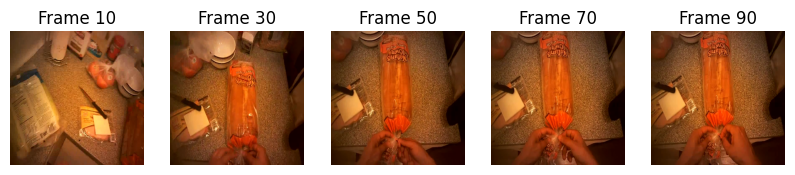

In [99]:
import cv2
import torch
import torchvision.transforms.functional as TF
import matplotlib.pyplot as plt

# Load video using OpenCV
video_path = "/content/TurkeySandwich/OP01-R02-TurkeySandwich-222550-230370-F005323-F005547.mp4"

cap = cv2.VideoCapture(video_path)

frames = []
frame_count = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    # Resize and convert to RGB
    frame_resized = cv2.resize(frame, (256, 256))
    frame_rgb = cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB)
    frames.append(frame_rgb)
    frame_count += 1
cap.release()

print("Number of frames loaded:", frame_count)

# Convert frames to tensor of shape [T, C, H, W]
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
video_tensor = torch.stack([TF.to_tensor(frame).to(device) for frame in frames])
print("Video tensor shape:", video_tensor.shape)

# Visualize sample frames
plt.figure(figsize=(10, 2))
for i, frame_idx in enumerate(range(10, len(frames), 20)):
    if i >= 5:
        break
    plt.subplot(1, 5, i + 1)
    plt.imshow(frames[frame_idx])
    plt.title(f"Frame {frame_idx}")
    plt.axis('off')
plt.show()


Number of frames loaded: 196
Video tensor shape: torch.Size([196, 3, 256, 256])


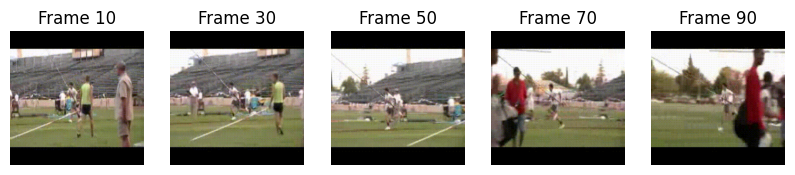

In [ ]:
# # gif = Image.open("/content/GIF/v_PoleVault_g01_c01.gif")
# gif = Image.open("/UCF101/v_PoleVault_g01_c01.gif")

# # Resize each frame to 256x256 using PIL's resize (bilinear interpolation)
# frames = [
#     frame.copy().convert('RGB').resize((256, 256), Image.BILINEAR)
#     for frame in ImageSequence.Iterator(gif)
# ]
# print("Number of frames loaded:", len(frames))

# # Convert frames to a tensor of shape [T, C, H, W]
# video_tensor = torch.stack([TF.to_tensor(frame).to(device) for frame in frames])
# print("Video tensor shape:", video_tensor.shape)


# plt.figure(figsize=(10, 2))
# # Use range to get frame indices instead of iterating over frames
# for i, frame_idx in enumerate(range(10, len(frames), 20)):
#     if i >= 5:  # Stop after 5 iterations
#         break
#     plt.subplot(1, 5, i+1)
#     plt.imshow(frames[frame_idx]) # Now frame_idx is an integer
#     plt.title(f"Frame {frame_idx}")
#     plt.axis('off')
# plt.show()

## 2 FlexTok inference

The FlexTok encoder maps an image into a one-dimensional sequence of 256 register tokens. These tokens are discretized using FSQ, resulting in a vocabulary of 64,000 tokens.

FlexTok was trained so that these quantized register tokens represent images in a hierarchical and ordered manner. Specifically, truncated subsequences of lengths _1, 2, 4, 8, 16, 32, 64, 128, and 256_ tokens all represent valid images, and as more tokens are used, the reconstructions increasingly resemble the encoded image. Although FlexTok was trained solely using a rectified flow and REPA objective, the truncated token sequences emerge as highly semantic compressions of the original image, capturing its most salient aspects with the fewest tokens.

To showcase this, we load here our largest FlexTok tokenizer (18 encoder layers, 28 decoder layers) trained on DFN. We load it directly from HuggingFace Hub. Please see the official repository for instructions on how to load models manually.

**Warning**: Executing the following cell will download a 10.2 GB model. This may take a while depending on your connection.

In [6]:
# Load a FlexTok d18-d28 model trained on DFN from HuggingFace Hub
flextok = FlexTokFromHub.from_pretrained('EPFL-VILAB/flextok_d18_d28_dfn').to(device).eval()

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/12.1k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/10.2G [00:00<?, ?B/s]

In [ ]:
# flextok

### 2.1 Autoencoding using all 256 tokens

First, a simple example of autoencoding images using FlexTok. We tokenize images into 256 tokens each using the FlexTok encoder. The first time this cell is run might take some time, but subsequent executions should be faster.

In [100]:
import torch._dynamo
torch._dynamo.config.suppress_errors = True

# Calculate frame indices to get exactly 16 frames evenly distributed across the video
total_frames = len(frames)
# Use linspace to get 16 evenly spaced indices
# frame_indices = torch.linspace(0, total_frames-1, 16).long().tolist()
frame_indices = torch.linspace(0, 16, 16).long().tolist()

print("Frames to tokenize:", frame_indices)

# Process selected frames
tokens_list = []
with get_bf16_context(enable_bf16):
    for frame_idx in frame_indices:
        if frame_idx < video_tensor.shape[0]:  # Check if the index is valid
            # Process one frame at a time: shape [1, C, H, W]
            frame = video_tensor[frame_idx].unsqueeze(0)
            tokens = flextok.tokenize(frame)
            tokens_list.append(tokens[0])  # Each tokens is expected to be of shape [1, 256]
            torch.cuda.empty_cache()  # Clear cached memory between iterations

print(f"Tokenized {len(tokens_list)} frames: {frame_indices}")

Frames to tokenize: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16]
Tokenized 16 frames: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16]


Then , we detokenize all 256 register tokens back into images using the FlexTok rectified flow decoder. There are three important hyperparameters for the rectified flow decoder:

- `timesteps`: Number of denoising steps. 25 steps provides a good balance between reconstruction quality and inference speed.
- `guidance_scale`: Classifier-free guidance scale. See the paper appendix for guidance scale sweeps for all models. We recommend guidance scale 7.5, except for the FlexTok d12-d12 model where we recommend guidance scale 15.
- `perform_norm_guidance`: Whether or not to perform Adaptive Projected Guidance (APG), see https://arxiv.org/abs/2410.02416. We recommend setting this to True.

In [101]:
# Print the shape of each token tensor in tokens_list
print("Shapes of token tensors for each frame:")
for idx, token in enumerate(tokens_list):
    print(f"Frame {idx+1}: {token.shape}")

# Alternatively, using a list comprehension
shapes = [t.shape for t in tokens_list[0]]
print("Shapes:", shapes)

Shapes of token tensors for each frame:
Frame 1: torch.Size([1, 256])
Frame 2: torch.Size([1, 256])
Frame 3: torch.Size([1, 256])
Frame 4: torch.Size([1, 256])
Frame 5: torch.Size([1, 256])
Frame 6: torch.Size([1, 256])
Frame 7: torch.Size([1, 256])
Frame 8: torch.Size([1, 256])
Frame 9: torch.Size([1, 256])
Frame 10: torch.Size([1, 256])
Frame 11: torch.Size([1, 256])
Frame 12: torch.Size([1, 256])
Frame 13: torch.Size([1, 256])
Frame 14: torch.Size([1, 256])
Frame 15: torch.Size([1, 256])
Frame 16: torch.Size([1, 256])
Shapes: [torch.Size([256])]


In [102]:
# Define token counts to test
token_counts = [16, 64, 256]
# token_counts = [256]
num_frames = 16  # This is fine since you're now using exactly 16 frames

# Create a dictionary to store all reconstructed frames by token count
all_reconstructions = {}

# Process each token count
for num_tokens in token_counts:
    print(f"\n=== Reconstructing with {num_tokens} tokens per frame ===")

    # Detokenize the frames that were tokenized
    reconst_frames_list = []

    with get_bf16_context(enable_bf16):
        for i in range(num_frames):  # Simply iterate through all 16 frames
            if i < len(tokens_list):  # Make sure we have tokens for this frame
                # Extract the specified number of tokens for this frame
                token_subset = tokens_list[i][:, :num_tokens]

                # Detokenize this frame
                reconst = flextok.detokenize(
                    [token_subset],
                    timesteps=20,
                    guidance_scale=7.5,
                    perform_norm_guidance=True,
                    verbose = False
                )
                # reconst is a tensor of shape [1, C, H, W]; extract the image
                reconst_frames_list.append(reconst[0])
                torch.cuda.empty_cache()  # Clear cached GPU memory
                print(f"Finished detokenizing frame {i+1}/{num_frames} with {num_tokens} tokens")

    # Stack the reconstructed frames together
    reconst_frames = torch.stack(reconst_frames_list)
    print(f"Reconstructed {reconst_frames.shape[0]} frames with {num_tokens} tokens.")

    # Store in our dictionary with token count as key
    all_reconstructions[num_tokens] = reconst_frames

    # Display the results
    batch_to_pil(reconst_frames)

    # Now you can access reconstructions by token count
    # Example: all_reconstructions[1] for 1-token reconstructions
    # Example: all_reconstructions[4] for 4-token reconstructions

print("\nAll reconstructions completed and stored!")
print(f"Available token counts: {list(all_reconstructions.keys())}")


=== Reconstructing with 16 tokens per frame ===
Finished detokenizing frame 1/16 with 16 tokens
Finished detokenizing frame 2/16 with 16 tokens
Finished detokenizing frame 3/16 with 16 tokens
Finished detokenizing frame 4/16 with 16 tokens
Finished detokenizing frame 5/16 with 16 tokens
Finished detokenizing frame 6/16 with 16 tokens
Finished detokenizing frame 7/16 with 16 tokens
Finished detokenizing frame 8/16 with 16 tokens
Finished detokenizing frame 9/16 with 16 tokens
Finished detokenizing frame 10/16 with 16 tokens
Finished detokenizing frame 11/16 with 16 tokens
Finished detokenizing frame 12/16 with 16 tokens
Finished detokenizing frame 13/16 with 16 tokens
Finished detokenizing frame 14/16 with 16 tokens
Finished detokenizing frame 15/16 with 16 tokens
Finished detokenizing frame 16/16 with 16 tokens
Reconstructed 16 frames with 16 tokens.

=== Reconstructing with 64 tokens per frame ===
Finished detokenizing frame 1/16 with 64 tokens
Finished detokenizing frame 2/16 with 6

### FVD Score

In [ ]:
def slices_of_16(pth, seg_len=16):
    """Yield tensors [T,C,H,W] for non‑overlapping 16‑frame chunks."""
    gif = Image.open(pth)
    frames = [frm.copy().convert('RGB').resize((256,256), Image.BILINEAR)
              for frm in ImageSequence.Iterator(gif)]
    n_seg = len(frames) // seg_len
    for s in range(n_seg):
        seg = frames[s*seg_len : (s+1)*seg_len]             # 16 PIL images
        vid = torch.stack([TF.to_tensor(f) for f in seg])   # [16,C,H,W] 0‑1
        yield vid                                           # stays on CPU

print(slices_of_16('/content/UCF101/v_ApplyEyeMakeup_g01_c01.gif', seg_len=16))

<generator object slices_of_16 at 0x7af895eccbf0>


In [ ]:
all_reconstructions[256].shape

torch.Size([16, 3, 256, 256])

In [ ]:
import torch
import einops
import numpy as np
from PIL import Image, ImageSequence
import torchvision.transforms.functional as TF
import math

from fvd import get_fvd_logits, frechet_distance          # the helper you pasted
from pytorch_i3d import InceptionI3d                      # same file you pasted

device = torch.device('cpu')

# ------------------ 1. load the I3D backbone ------------------
i3d = InceptionI3d(400, in_channels=3).eval().to(device)
i3d.load_state_dict(torch.load('i3d_pretrained_400.pt', map_location=device))
i3d = torch.nn.DataParallel(i3d)                          # exactly what the helper expects


# ------------------ 2. prepare the two clips ------------------
#  ❱ video_tensor : [196, 3, 256, 256]
real_clip = video_tensor[:16]                             # [16,3,256,256]
real_clip = real_clip.permute(1,0,2,3).unsqueeze(0)       # -> [1,3,16,256,256]

#  ❱ all_reconstructions[256] : [16, 3, 256, 256]
recon_clip = all_reconstructions[256].permute(1,0,2,3).unsqueeze(0)  # [1,3,16,256,256]

real_clip  = real_clip.to(device)
recon_clip = recon_clip.to(device)

# ------------------ 3. I3D embeddings ------------------
with torch.no_grad():
    emb_real  = get_fvd_logits(real_clip,  i3d, device)   # [1, N_feats]
    emb_fake  = get_fvd_logits(recon_clip, i3d, device)

# ------------------ 4. Fréchet Video Distance ------------------
fvd_score = frechet_distance(emb_real.cpu(), emb_fake.cpu())
print(f"FVD (first 16 frames): {fvd_score:.2f}")


FVD (first 16 frames): 13.31


### FVD with first 16 frames Input (Update with fvd.py)

In [7]:
import zipfile
import os

with zipfile.ZipFile("/content/short_clips_by_food.zip", 'r') as zip_ref:
    zip_ref.extractall("/content/")

# Now your videos are in ./data/short_clips_by_food/

In [27]:
import os, glob, math, torch, cv2
import torchvision.transforms.functional as TF
from fvd import get_fvd_logits, frechet_distance
from pytorch_i3d import InceptionI3d
# from flextok_hub import FlexTokFromHub, get_bf16_context  # <- your helpers

# -------------------------- configuration --------------------------
VIDEO_DIR       = "/content/Pizza/"
N_FRAMES        = 16          # use the first 16 frames
TOKENS_PER_FR   = 16         # FlexTok setting
DEVICE          = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
ENABLE_BF16     = torch.cuda.is_available()                # bf16 only on GPU
# -------------------------------------------------------------------

# ---------- 1. I3D backbone ---------------------------------------
i3d = InceptionI3d(400, in_channels=3).eval().to(DEVICE)
i3d.load_state_dict(torch.load('/i3d_pretrained_400.pt', map_location=DEVICE))
i3d = torch.nn.DataParallel(i3d)

# ---------- 2. FlexTok model --------------------------------------
# flextok = FlexTokFromHub.from_pretrained(
#     'EPFL-VILAB/flextok_d18_d28_dfn').to(DEVICE).eval()

# ---------- 3. helper to read + resize + tensorise 16 frames -------
def first_16_as_tensor(video_path):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while len(frames) < N_FRAMES and cap.isOpened():
        ret, frame = cap.read()
        if not ret: break
        frame = cv2.resize(frame, (256, 256))
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(torch.tensor(frame).permute(2, 0, 1) / 255.0)
    cap.release()

    if len(frames) < N_FRAMES:
        return None
    return torch.stack(frames)  # [T, C, H, W]

# ---------- 4. iterate over dataset -------------------------------
real_clips, recon_clips = [], []

for video_path in sorted(glob.glob(os.path.join(VIDEO_DIR, '*.mp4'))):
    vid = first_16_as_tensor(video_path)
    if vid is None: continue

    # --- tokenise & detokenise each frame (on GPU) -----------------
    tokens_per_frame = []
    with get_bf16_context(ENABLE_BF16):
        for fr in vid:  # fr: [C, H, W]
            toks = flextok.tokenize(fr.unsqueeze(0).to(DEVICE))  # [1,256]
            tokens_per_frame.append(toks[0][:, :TOKENS_PER_FR])

        reconst = torch.stack([
            flextok.detokenize([t], timesteps=20,
                               guidance_scale=7.5,
                               perform_norm_guidance=True,
                               verbose=False)[0].cpu()
            for t in tokens_per_frame
        ])  # [T, C, H, W]

    real_clips.append(vid.permute(1, 0, 2, 3))   # [C, T, H, W]
    recon_clips.append(reconst.permute(1, 0, 2, 3))

    print(f"✓ processed {os.path.basename(video_path)}")

assert real_clips, "No videos with ≥16 frames found."

# ---------- 5. stack into batches [N, C, T, H, W] ------------------
real_set  = torch.stack(real_clips)
recon_set = torch.stack(recon_clips)

# ---------- 6. compute FVD ----------------------------------------
with torch.no_grad():
    emb_real = get_fvd_logits(real_set.to('cpu'), i3d, device='cpu')
    emb_fake = get_fvd_logits(recon_set.to('cpu'), i3d, device='cpu')

fvd = frechet_distance(emb_fake.cpu(), emb_real.cpu())
print(f"\nFVD over {len(real_set)} videos (first 16 frames each): {fvd:.2f}")


✓ processed OP01-R07-Pizza-216058-223293-F005168-F005377.mp4
✓ processed OP01-R07-Pizza-225969-231439-F005410-F005568.mp4
✓ processed OP01-R07-Pizza-256160-261110-F006135-F006279.mp4
✓ processed OP01-R07-Pizza-330717-336129-F007924-F008081.mp4
✓ processed OP01-R07-Pizza-361770-367380-F008669-F008831.mp4
✓ processed OP01-R07-Pizza-381100-386480-F009133-F009289.mp4
✓ processed OP01-R07-Pizza-497940-502940-F011938-F012083.mp4
✓ processed OP01-R07-Pizza-526740-532070-F012628-F012783.mp4
✓ processed OP01-R07-Pizza-644890-650040-F015465-F015613.mp4
✓ processed OP01-R07-Pizza-725820-731650-F017405-F017574.mp4
✓ processed OP01-R07-Pizza-88220-92680-F002107-F002235.mp4
✓ processed OP02-R07-Pizza-366664-370804-F008789-F008910.mp4
✓ processed OP02-R07-Pizza-397170-402383-F009520-F009670.mp4
✓ processed OP02-R07-Pizza-448277-454705-F010743-F010928.mp4
✓ processed OP02-R07-Pizza-656144-660480-F015737-F015862.mp4

FVD over 15 videos (first 16 frames each): 59.77


In [ ]:
print(get_fvd_logits(real_set[:2], i3d, 'cpu').shape)

torch.Size([2, 1024])


### FVD all 16 frames Input (Update with fvd.py)

In [ ]:
import os, glob, math, torch, cv2
import torchvision.transforms.functional as TF
from fvd import get_fvd_logits, frechet_distance
from pytorch_i3d import InceptionI3d
# from flextok_hub import FlexTokFromHub, get_bf16_context  # <- your helpers

# -------------------------- configuration --------------------------
VIDEO_DIR       = "/content/EGTEA/"
SEG_LEN         = 16
TOKENS_PER_FR   = 256
DEVICE          = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
ENABLE_BF16     = torch.cuda.is_available()
# -------------------------------------------------------------------

# ---------- 1. I3D backbone ---------------------------------------
i3d = InceptionI3d(400, in_channels=3).eval().to(DEVICE)
i3d.load_state_dict(torch.load('i3d_pretrained_400.pt', map_location=DEVICE))
i3d = torch.nn.DataParallel(i3d)

# ---------- 2. FlexTok model --------------------------------------
# flextok = FlexTokFromHub.from_pretrained(
#     'EPFL-VILAB/flextok_d18_d28_dfn').to(DEVICE).eval()

# ---------- 3. helper to read + slice into 16-frame tensors ----------
def slices_of_16(path):
    cap = cv2.VideoCapture(path)
    frames = []
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        frame = cv2.resize(frame, (256, 256))
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(torch.tensor(frame).permute(2, 0, 1).float() / 255.)
    cap.release()

    total_segments = len(frames) // SEG_LEN
    for s in range(total_segments):
        seg = frames[s * SEG_LEN: (s + 1) * SEG_LEN]
        yield torch.stack(seg)  # [16, C, H, W]

# ---------- 4. iterate over MP4s & all their 16-frame chunks -------
real_clips, recon_clips = [], []

for vid_idx, vid_path in enumerate(sorted(glob.glob(os.path.join(VIDEO_DIR, '*.mp4'))), 1):
    print(f"\n[{vid_idx}] {os.path.basename(vid_path)}")
    for seg_idx, vid in enumerate(slices_of_16(vid_path), 1):
        print(f"  slice {seg_idx}", end=' ', flush=True)

        # ------- tokenise & detokenise one 16‑frame clip ------------
        tokens_per_frame = []
        with get_bf16_context(ENABLE_BF16):
            for fr in vid:  # fr : [C,H,W]
                toks = flextok.tokenize(fr.unsqueeze(0).to(DEVICE))  # [1, 256]
                tokens_per_frame.append(toks[0][:, :TOKENS_PER_FR])  # trim

            reconst = torch.stack([
                flextok.detokenize([t], timesteps=20,
                                   guidance_scale=7.5,
                                   perform_norm_guidance=True,
                                   verbose=False)[0].cpu()
                for t in tokens_per_frame
            ])  # [16, C, H, W]

        real_clips.append(vid.permute(1, 0, 2, 3))     # -> [C, T, H, W]
        recon_clips.append(reconst.permute(1, 0, 2, 3))

    print(f"✓ processed {os.path.basename(vid_path)} "
          f"({seg_idx}×16‑frame segments)")

assert real_clips, "No 16‑frame segments found in the dataset."

# ---------- 5. stack into batches [N, C, T, H, W] ------------------
real_set  = torch.stack(real_clips)       # float 0‑1
recon_set = torch.stack(recon_clips)

# ---------- 6. compute FVD ----------------------------------------
with torch.no_grad():
    emb_real = get_fvd_logits(real_set.to('cpu'), i3d, device='cpu')
    emb_fake = get_fvd_logits(recon_set.to('cpu'), i3d, device='cpu')

fvd = frechet_distance(emb_fake.cpu(), emb_real.cpu())
print(f"\nFVD over {len(real_set)} video segments (each 16 frames): {fvd:.2f}")



[1] OP01-R01-PastaSalad-169990-176650-F004063-F004256.mp4
  slice 1   slice 2   slice 3   slice 4   slice 5   slice 6   slice 7   slice 8   slice 9   slice 10   slice 11   slice 12 ✓ processed OP01-R01-PastaSalad-169990-176650-F004063-F004256.mp4 (12×16‑frame segments)

[2] OP01-R02-TurkeySandwich-282450-286630-F006768-F006890.mp4
  slice 1   slice 2   slice 3   slice 4   slice 5   slice 6   slice 7 ✓ processed OP01-R02-TurkeySandwich-282450-286630-F006768-F006890.mp4 (7×16‑frame segments)

FVD over 19 video segments (each 16 frames): 34.87


### Display Detokenize

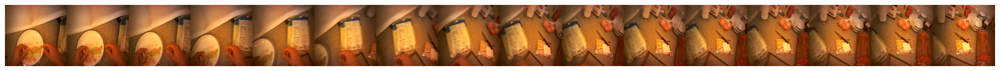

In [103]:
# Get original frames based on frame_indices
original_frames = [frames[idx] for idx in frame_indices[:num_frames]]

# Convert all frames to numpy arrays if they aren't already
frame_arrays = [np.array(frame) for frame in original_frames]

# Calculate the total width and maximum height
total_width = sum(frame.shape[1] for frame in frame_arrays)
max_height = max(frame.shape[0] for frame in frame_arrays)

# Create a new blank image
stacked_image = np.zeros((max_height, total_width, 3), dtype=np.uint8)

# Paste each frame side by side
current_x = 0
for frame in frame_arrays:
    h, w = frame.shape[:2]
    stacked_image[:h, current_x:current_x+w] = frame
    current_x += w

# Convert to PIL image and display
stacked_pil = Image.fromarray(stacked_image)
plt.figure(figsize=(20, 4))
plt.imshow(stacked_pil)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [104]:
import torch
from torchvision.transforms.functional import to_pil_image
import os

def save_reconstruction_gif(tensor, filename="reconstruction.gif", fps=5):
    """
    Converts a [T, 3, H, W] tensor to a GIF.

    Args:
        tensor (torch.Tensor): shape [T, 3, H, W], values should be [0, 1]
        filename (str): output file path
        fps (int): frames per second in the GIF

    Returns:
        Saves a GIF file to `filename`
    """
    # Safety check: clamp values and move to CPU
    tensor = torch.clamp(tensor, 0, 1).cpu()

    # Convert each frame to PIL image
    frames = [to_pil_image(frame) for frame in tensor]

    # Compute duration in milliseconds
    duration = int(1000 / fps)

    # Save as animated GIF
    frames[0].save(
        filename,
        save_all=True,
        append_images=frames[1:],
        duration=duration,
        loop=0
    )
    print(f"✅ Saved GIF to: {os.path.abspath(filename)}")

save_reconstruction_gif(all_reconstructions[16], "/content/TurkeySandwich/reconstruction_16.gif", fps=3)
save_reconstruction_gif(all_reconstructions[64], "/content/TurkeySandwich/reconstruction_64.gif", fps=3)
save_reconstruction_gif(all_reconstructions[256], "/content/TurkeySandwich/reconstruction_256.gif", fps=3)

✅ Saved GIF to: /content/TurkeySandwich/reconstruction_16.gif
✅ Saved GIF to: /content/TurkeySandwich/reconstruction_64.gif
✅ Saved GIF to: /content/TurkeySandwich/reconstruction_256.gif


In [37]:
batch_to_pil(all_reconstructions[256])

torch.Size([16, 3, 256, 256])

In [38]:
batch_to_pil(all_reconstructions[16])
all_reconstructions[16].shape

torch.Size([16, 3, 256, 256])

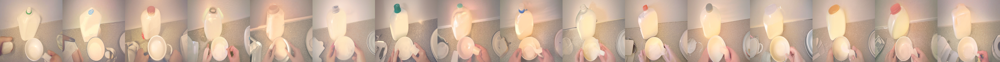

In [35]:
batch_to_pil(all_reconstructions[64])

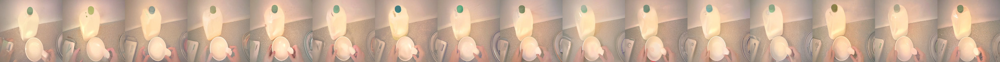

In [36]:
batch_to_pil(all_reconstructions[256])

In [ ]:
# batch_to_pil(all_reconstructions[64])

In [ ]:
# batch_to_pil(all_reconstructions[128])

In [ ]:
# Load and process GIF
def process_gif(gif_path, token_counts=[1, 4, 16, 32, 64, 128]):
    # Load GIF and resize frames
    gif = Image.open(gif_path)
    frames = [
        frame.copy().convert('RGB').resize((256, 256), Image.BILINEAR)
        for frame in ImageSequence.Iterator(gif)
    ]
    print(f"Number of frames loaded: {len(frames)}")

    # Convert to tensor
    video_tensor = torch.stack([TF.to_tensor(frame).to(device) for frame in frames])
    print(f"Video tensor shape: {video_tensor.shape}")

    # Select frames to process (every 10th frame + last frame)
    frame_indices = list(range(10, min(191, len(frames)), 10)) + [len(frames)-1]
    print(f"Frames to tokenize: {frame_indices}")

    # Tokenize selected frames
    tokens_list = []
    with get_bf16_context(enable_bf16):
        for frame_idx in frame_indices:
            frame = video_tensor[frame_idx].unsqueeze(0)
            tokens = flextok.tokenize(frame)
            tokens_list.append(tokens[0])
            print(f"Tokenized frame {frame_idx}")
            torch.cuda.empty_cache()

    # Reconstruct frames with different token counts
    all_reconstructions = {}
    num_frames = len(tokens_list)

    for num_tokens in token_counts:
        print(f"\n=== Reconstructing with {num_tokens} tokens per frame ===")
        reconst_frames_list = []

        with get_bf16_context(enable_bf16):
            for i, frame_idx in enumerate(frame_indices[:num_frames]):
                token_subset = tokens_list[i][:, :num_tokens]

                reconst = flextok.detokenize(
                    [token_subset],
                    timesteps=25,
                    guidance_scale=7.5,
                    perform_norm_guidance=True,
                    generator=get_generator(seed=0, device=device),
                    verbose=False
                )
                reconst_frames_list.append(reconst[0])
                torch.cuda.empty_cache()
                print(f"Finished frame {frame_idx} ({i+1}/{num_frames}) with {num_tokens} tokens")

        reconst_frames = torch.stack(reconst_frames_list)
        all_reconstructions[num_tokens] = reconst_frames
        print(f"Reconstructed {reconst_frames.shape[0]} frames with {num_tokens} tokens")

    # Display original frames
    display_originals(frames, frame_indices, num_frames)

    return all_reconstructions

# Display original frames as a strip
def display_originals(frames, frame_indices, num_frames):
    import numpy as np

    # Get original frames
    original_frames = [frames[idx] for idx in frame_indices[:num_frames]]

    # Convert to numpy arrays
    frame_arrays = [np.array(frame) for frame in original_frames]

    # Calculate dimensions
    total_width = sum(frame.shape[1] for frame in frame_arrays)
    max_height = max(frame.shape[0] for frame in frame_arrays)

    # Create stacked image
    stacked_image = np.zeros((max_height, total_width, 3), dtype=np.uint8)

    # Paste frames side by side
    current_x = 0
    for frame in frame_arrays:
        h, w = frame.shape[:2]
        stacked_image[:h, current_x:current_x+w] = frame
        current_x += w

    # Display
    stacked_pil = Image.fromarray(stacked_image)
    plt.figure(figsize=(20, 4))
    plt.imshow(stacked_pil)
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()

all_reconstructions = process_gif("/content/EGTEA/OP01-R01-PastaSalad-169990-176650-F004063-F004256.mp4")

UnidentifiedImageError: cannot identify image file '/content/EGTEA/OP01-R01-PastaSalad-169990-176650-F004063-F004256.mp4'

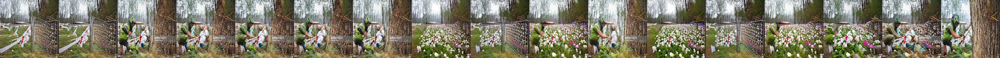

In [ ]:
batch_to_pil(all_reconstructions[1])

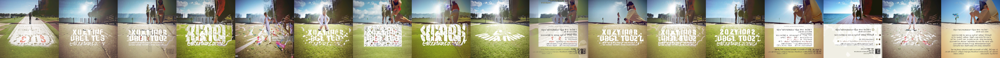

In [ ]:
batch_to_pil(all_reconstructions[4])

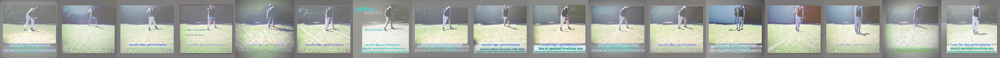

In [ ]:
batch_to_pil(all_reconstructions[16])

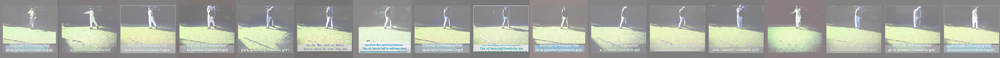

In [ ]:
batch_to_pil(all_reconstructions[32])

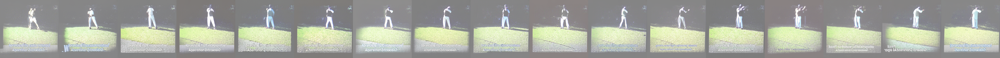

In [ ]:
batch_to_pil(all_reconstructions[64])

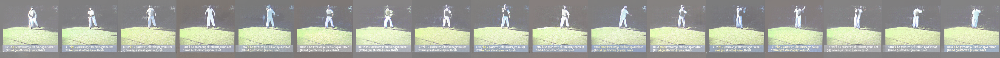

In [ ]:
batch_to_pil(all_reconstructions[128])

### Bike Example

Finished detokenizing bike1.jpg with 256 tokens
Finished detokenizing bike2.jpg with 256 tokens
Finished detokenizing bike3.jpg with 256 tokens
Finished detokenizing bike4.jpg with 256 tokens
Finished detokenizing bike5.jpg with 256 tokens
Reconstructed 5 frames.


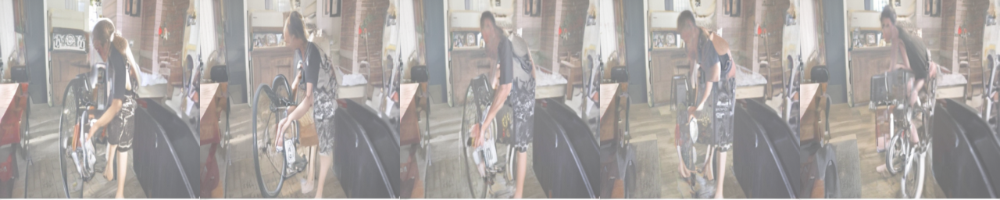

In [ ]:
# Detokenize the frames
reconst_frames_list = []

with get_bf16_context(enable_bf16):
    for i in range(len(tokens_list)):  # Process all tokenized frames
        # Use all 32 tokens for this frame
        first_token = tokens_list[i][:, :256]  # Changed from :1 to :32

        # Detokenize this frame
        reconst = flextok.detokenize(
            [first_token],
            timesteps=25,
            guidance_scale=7.5,
            perform_norm_guidance=True,
            generator=get_generator(seed=0, device=device),
            verbose=False
        )
        # reconst is a tensor of shape [1, C, H, W]; extract the image using index 0
        reconst_frames_list.append(reconst[0])
        torch.cuda.empty_cache()  # Clear cached GPU memory between iterations
        print(f"Finished detokenizing bike{i+1}.jpg with 256 tokens")

# Stack the reconstructed frames together
reconst_frames = torch.stack(reconst_frames_list)
print("Reconstructed", reconst_frames.shape[0], "frames.")
batch_to_pil(reconst_frames)

### 2.2 Flexible-length tokenization

Now we encode each image once and show reconstructions from the first _1, 2, 4, ..., 256_ tokens. Practically this means truncating the token sequences from the right, keeping only the chosen number of tokens, and running the rectified flow decoder on only that subset of tokens.

In [ ]:
def plot_flexible_length_reconsts(imgs, k_keep_list, figscale=3.0, seed=None):
    # Tokenize images once
    with get_bf16_context(enable_bf16):
        tokens_list = flextok.tokenize(imgs) # List of [1, 256] discrete token sequences

    # Detokenize various subsequences
    all_reconst = {}
    for k_keep in k_keep_list:
        # Simply truncate the token sequences from the right
        subseq_list = [seq[:,:k_keep].clone() for seq in tokens_list]
        with get_bf16_context(enable_bf16):
            generator = get_generator(seed=seed, device=device)
            all_reconst[k_keep] = flextok.detokenize(
                subseq_list, timesteps=25,
                guidance_scale=7.5, perform_norm_guidance=True,
                generator=generator, verbose=False,
            )

    # Plotting
    ncols = len(k_keep_list) + 1 # 1 | 2 | 4 | ... | 256 | GT
    nrows = imgs.shape[0]

    fig, axes = plt.subplots(nrows, ncols, figsize=(figscale*ncols, figscale*nrows))
    axes = [axes] if nrows == 1 else axes

    imgs_plot = denormalize(imgs)
    all_reconst = {k_keep: denormalize(rec).clamp(0,1) for k_keep, rec in all_reconst.items()}

    for img_idx in range(nrows):
        for col_idx, k_keep in enumerate(k_keep_list):
            axes[img_idx][col_idx].imshow(TF.to_pil_image(all_reconst[k_keep][img_idx]))
        axes[img_idx][-1].imshow(TF.to_pil_image(imgs_plot[img_idx]))

        for ax in axes[img_idx]:
            ax.axis("off")

    for col_idx, k_keep in enumerate(k_keep_list):
        title = f'{k_keep} token' + ('' if k_keep == 1 else 's')
        axes[0][col_idx].set_title(title, fontsize=18)
    axes[0][-1].set_title('Groundtruth', fontsize=18)

    plt.tight_layout()
    plt.show()

Below are the reconstructions from various subsequences. Even with a high degree of compression (each token can only be one of 64'000 classes, i.e. takes up 2 bytes), the reconstructions capture the most important high-level semantic and geometric information first. In the first example, with merely 4 tokens FlexTok captures the essence of a painted bird looking towards the right.

Depending on the image complexity, different number of tokens are required to faithfully reconstruct the given images. For example, simple images that contain only one central object (like the apple) can be reconstructed well with as few as 1-16 tokens. By this we mean that the main concept, here "single apple in front of neutral background" is faithfully captured, while details like the length of the stem or texture on the fruit are abstracted away. On the other hand, more complex scenes like the image of a crowd of people requires 64-256 tokens to capture the position and clothing of each person, while the gist of the scene is captured by only 4 tokens.

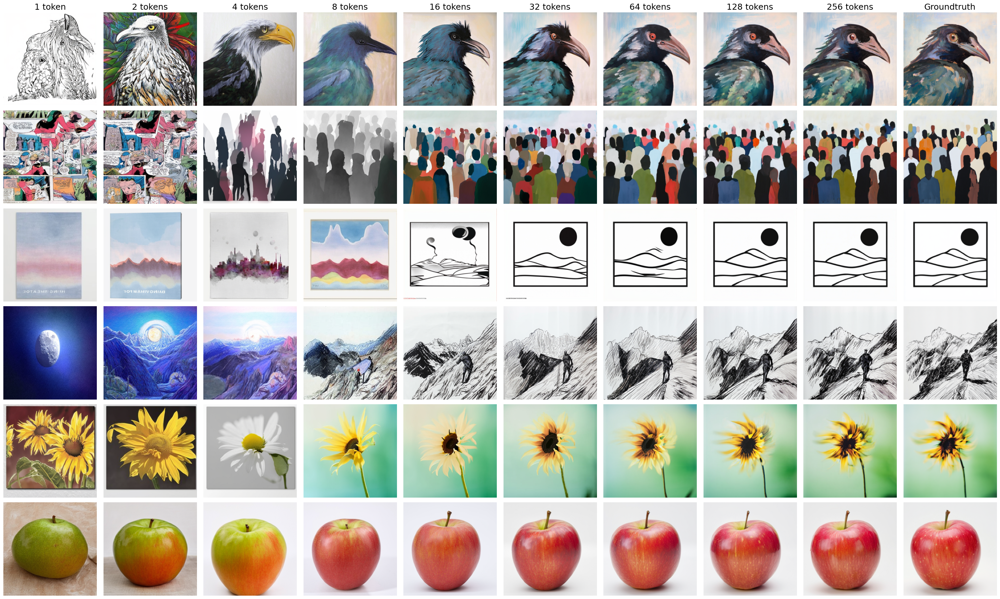

In [ ]:
k_keep_list = [1, 2, 4, 8, 16, 32, 64, 128, 256]
plot_flexible_length_reconsts(imgs, k_keep_list, seed=0)

## 3 VAE-GAN inference

All FlexTok models operate on top of a VAE-GAN latent space, similar to the one of SDXL. Similar to SD3's findings, we found the 4-channel SDXL VAE-GAN compression to be too strong for subsequent use and decided to train our own VAE-GAN models with 4, 8, and 16 channels and a downsampling factor of 8. For all FlexTok models we used the 16-channel version.

In the following we show how to load our VAE-GAN models and autoencode the loaded images.

### 3.1 Helper functions

In [ ]:
def vae_encode(imgs, vae_model):
    scaling_factor = vae_model.config['scaling_factor']
    return vae_model.encode(imgs).latent_dist.sample() * scaling_factor

def vae_decode(latents, vae_model):
    scaling_factor = vae_model.config['scaling_factor']
    return vae_model.decode(latents / scaling_factor).sample

def plot_vae_reconst(imgs, reconst_sdxl_c4, reconst_c4, reconst_c8, reconst_c16, figscale=3.0):
    ncols = 5 # SDXL ch4 | ch4 | ch8 | ch16 | GT
    nrows = imgs.shape[0]

    fig, axes = plt.subplots(nrows, ncols, figsize=(figscale*ncols, figscale*nrows))
    axes = [axes] if nrows == 1 else axes

    imgs_plot = denormalize(imgs)
    reconst_sdxl_c4_plot = denormalize(reconst_sdxl_c4).clamp(0,1)
    reconst_c4_plot = denormalize(reconst_c4).clamp(0,1)
    reconst_c8_plot = denormalize(reconst_c8).clamp(0,1)
    reconst_c16_plot = denormalize(reconst_c16).clamp(0,1)

    for img_idx in range(nrows):
        axes[img_idx][0].imshow(TF.to_pil_image(reconst_sdxl_c4_plot[img_idx]))
        axes[img_idx][1].imshow(TF.to_pil_image(reconst_c4_plot[img_idx]))
        axes[img_idx][2].imshow(TF.to_pil_image(reconst_c8_plot[img_idx]))
        axes[img_idx][3].imshow(TF.to_pil_image(reconst_c16_plot[img_idx]))
        axes[img_idx][4].imshow(TF.to_pil_image(imgs_plot[img_idx]))

        for ax in axes[img_idx]:
            ax.axis("off")

    axes[0][0].set_title('4-channel SDXL VAE')
    axes[0][1].set_title('4-channel FlexTok VAE')
    axes[0][2].set_title('8-channel FlexTok VAE')
    axes[0][3].set_title('16-channel FlexTok VAE')
    axes[0][4].set_title('GT')

    plt.tight_layout()
    plt.show()

### 3.2 Load VAE-GAN models

All VAE-GAN models use the same architecture as the SDXL VAE, but differ in the number of latent channels. They can be loaded from HuggingFace Hub using `diffusers.models.AutoencoderKL`.

In [ ]:
vae_c4  = AutoencoderKL.from_pretrained('EPFL-VILAB/flextok_vae_c4', low_cpu_mem_usage=False).to(device).eval()
vae_c8  = AutoencoderKL.from_pretrained('EPFL-VILAB/flextok_vae_c8', low_cpu_mem_usage=False).to(device).eval()
vae_c16 = AutoencoderKL.from_pretrained('EPFL-VILAB/flextok_vae_c16', low_cpu_mem_usage=False).to(device).eval()

We also load a baseline SDXL VAE for comparison:

In [ ]:
vae_sdxl_c4 = AutoencoderKL.from_pretrained('stabilityai/sdxl-vae', low_cpu_mem_usage=False).to(device).eval()

### 3.3 Plot reconstructions

In the following, we show reconstructions from each VAE. The VAEs map images of size 256x256 pixels to a 4, 8, or 16 channel latent space of height and width 32x32.

In [ ]:
reconst_c4  = vae_decode(vae_encode(imgs, vae_c4), vae_c4)
reconst_c8  = vae_decode(vae_encode(imgs, vae_c8), vae_c8)
reconst_c16 = vae_decode(vae_encode(imgs, vae_c16), vae_c16)

reconst_sdxl_c4  = vae_decode(vae_encode(imgs, vae_sdxl_c4), vae_sdxl_c4)

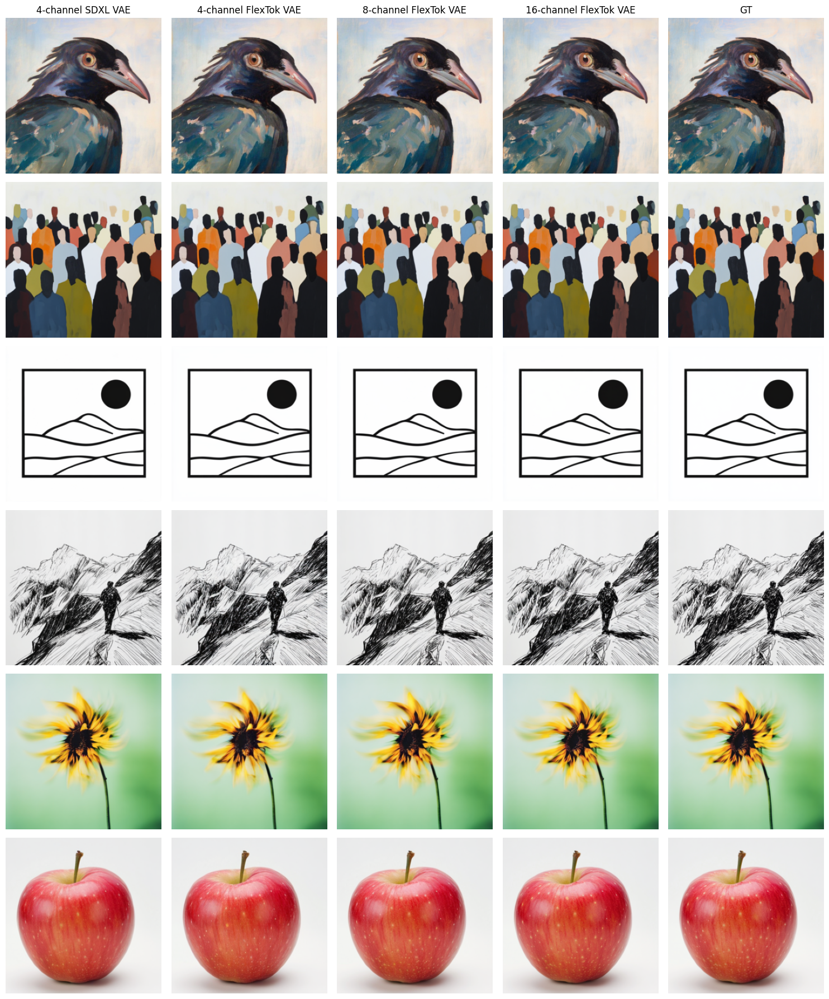

In [ ]:
plot_vae_reconst(imgs, reconst_sdxl_c4, reconst_c4, reconst_c8, reconst_c16)